# Tanzania - (most) wrangling done

Import csv file

In [4]:
import numpy as np
import pandas as pd
import matplotlib as plot
import seaborn as sns

df = pd.read_csv('/Users/RAhmed/data store/Wesleyan_Capstone/corrected_data04.csv')
# df.head()

# Get rid of NaNs

In [5]:
# check which column has NaNs
df.isna().any()

id                       False
date_recorded            False
season_recorded          False
gps_height               False
installer                 True
longitude                False
latitude                 False
basin                    False
region_code              False
population               False
public_meeting            True
scheme_management         True
permit                    True
wpt_age                  False
construction_year        False
extraction_type_group    False
management_group         False
payment_type             False
water_quality            False
quantity_group           False
source_type              False
source_class             False
waterpoint_type_group    False
status_group             False
dtype: bool

In [6]:
df['installer'].isnull().sum()

194

In [7]:
df['public_meeting'].isnull().sum()

7291

In [8]:
df['scheme_management'].isnull().sum()

3143

In [9]:
df['permit'].isnull().sum()

127

There are relatively a lot of NaNs in public_meeting so ignoring these will remove valuable info. Also, the test set is likey to have NaNs, so we need to come up with consistent treatment that will also be used on the test set.  For all of these I will turn NaN into 'unknown'.

Test on one example first.

In [10]:
df['installer'].fillna(value='unknown', inplace=True)
print('unknown' in df.installer.unique())
print(df['installer'].isnull().sum())
print((df['installer'] == 'unknown').sum())

True
0
194


Note that the public_meeting variable is boolean, so this has to be treated differently.

In [11]:
print(df['public_meeting'].isnull().sum())
print(df['public_meeting'].value_counts())

7291
True     47359
False     4750
Name: public_meeting, dtype: int64


In [12]:
def bool_converter(bool):
    if bool == False:
        return 0
    elif bool == True:
        return 1
    else: 
        return 2

df['public_meeting'] = df['public_meeting'].apply(bool_converter)
print(df['public_meeting'].value_counts())

1    47359
2     7291
0     4750
Name: public_meeting, dtype: int64


scheme_management can be done in non-boolean fashion, like installer, above.

In [13]:
df['scheme_management'].fillna(value='unknown', inplace=True)
print('unknown' in df.scheme_management.unique())
print(df['scheme_management'].isnull().sum())
print((df['scheme_management'] == 'unknown').sum())

True
0
3143


In [14]:
df['permit'] = df['permit'].apply(bool_converter)
print(df['permit'].value_counts())

1    37492
0    21781
2      127
Name: permit, dtype: int64


# Make categorical again!

Needs to be done as I have a fresh read-in of file

In [256]:
# df.columns

In [255]:
# for item in categories:
#     df[item] = df[item].astype('category')
# check types
# df.dtypes

# Exploratory Data Analysis

Explore using Roland Jeannier's function

In [15]:
def eda_helper(df):
   dict_list = []
   for col in df.columns:
       data = df[col]
       dict_ = {}
       # The null count for a column. 
       dict_.update({"null_count" : data.isnull().sum()})
       # Counting the unique values in a column
       dict_.update({"unique_count" : len(data.unique())})
       # Finding the types of data in the column
       # This is useful for finding out potential problems with type mismatches
       dict_.update({"data_type" : set([type(d).__name__ for d in data])})
       #dict_.update({"score" : match[1]})
       dict_list.append(dict_)
   eda_df = pd.DataFrame(dict_list)
   eda_df.index = df.columns
   eda_df.sort_values(by=['null_count', 'unique_count'], ascending=[True, False], inplace=True)
       
   return eda_df

In [16]:
print(eda_helper(df))

                      data_type  null_count  unique_count
id                        {int}           0          9400
longitude               {float}           0          7589
latitude                {float}           0          7589
gps_height                {int}           0          1580
wpt_age                 {float}           0          1274
installer                 {str}           0           219
date_recorded           {float}           0           184
construction_year       {float}           0           165
extraction_type_group     {str}           0            12
region_code               {int}           0            11
scheme_management         {str}           0            11
population                {str}           0             9
water_quality             {str}           0             8
payment_type              {str}           0             7
source_type               {str}           0             7
basin                     {str}           0             5
management_gro

Make the right variables categorical

In [257]:
# categories = {'extraction_type_group', 'region_code', 'population', 'water_quality',
#              'payment_type', 'source_type', 'basin', 'management_group', 'quantity_group',
#               'season_recorded', 'waterpoint_type_group', 'source_class','status_group', 'permit',
#               'installer', 'scheme_management', 'public_meeting'
#              }
# for item in categories:
#     df[item] = df[item].astype('category')
# # check types
# df.dtypes

In [16]:
max(df['date_recorded'])

2013.924731182796

In [17]:
min(df['date_recorded'])

2004.1693548387095

# Initial looks at categorical variables

In [260]:
df['season_recorded'].value_counts()

short_dry      46170
long_dry        6483
long_rainy      5749
short_rainy      998
Name: season_recorded, dtype: int64

In [261]:
df['installer'].value_counts()

DWE                          11013
Fin Water                     9449
DANIDA                        8162
LGA                           4477
Government                    3637
UNICEF                        2651
Japan Government              1991
TASAF                         1632
District Water Department     1430
Amref                         1254
MWE                           1034
Region Water Department       1023
District Council               935
Mission                        451
GEN                            429
MBIUWASA                       385
VWC                            352
KIUMA                          352
Hesawa                         343
CJEJOW                         341
Makonde                        341
ABASIA                         319
MTUWASA                        286
wanan                          253
Ndanda missions                242
WORLD BANK                     241
Private                        222
Individuals                    220
SOWASA              

In [262]:
df['installer'].nunique()

219

In [263]:
df['basin'].value_counts()

Ruvuma / Southern Coast    40843
Lake Nyasa                 11330
Lake Victoria               4301
Rufiji                      2827
Lake Tanganyika               99
Name: basin, dtype: int64

Previously the number of unique installer was 466

In [264]:
df['region_code'].value_counts()        

10    27401
90    10087
99     4653
9      4290
80     4114
8      3245
18     1752
11     1136
17     1057
20      910
19      755
Name: region_code, dtype: int64

In [265]:
df['population'].value_counts()

100      20505
1        12574
500       9340
0         7491
1000      5417
1000+     2094
50        1622
30         307
20          50
Name: population, dtype: int64

In [266]:
df['public_meeting'].value_counts()

1    47359
2     7291
0     4750
Name: public_meeting, dtype: int64

In [267]:
df['scheme_management'].value_counts()

VWC                 43259
WUG                  5943
Water Board          3169
unknown              3143
Other                1125
WUA                  1018
Parastatal            875
Private operator      503
Water authority       332
Trust                  22
Company                11
Name: scheme_management, dtype: int64

In [268]:
df['permit'].value_counts()

1    37492
0    21781
2      127
Name: permit, dtype: int64

In [269]:
df['extraction_type_group'].value_counts()

gravity            22450
submersible         9307
other               8661
swn 80              5262
india mark ii       5232
nira/tanira         4190
mono                2496
other handpump      1122
afridev              280
india mark iii       194
rope pump            189
other motorpump       17
Name: extraction_type_group, dtype: int64

In [270]:
df['management_group'].value_counts()

user-group    54727
parastatal     1556
other          1210
commercial     1046
unknown         861
Name: management_group, dtype: int64

In [271]:
df['payment_type'].value_counts()

never pay     17050
per bucket    11834
unknown       11196
monthly        8554
on failure     5301
annually       4821
other           644
Name: payment_type, dtype: int64

In [272]:
df['water_quality'].value_counts()

soft                  49842
salty                  5904
unknown                2507
milky                   498
coloured                355
salty abandoned         267
fluoride                 25
fluoride abandoned        2
Name: water_quality, dtype: int64

In [273]:
df['quantity_group'].value_counts()

enough          27363
dry             15174
insufficient    11294
seasonal         4925
unknown           644
Name: quantity_group, dtype: int64

In [274]:
df['source_type'].value_counts()

borehole                18560
shallow well            15991
spring                  14033
river/lake               9338
rainwater harvesting      990
dam                       391
other                      97
Name: source_type, dtype: int64

In [275]:
df['source_class'].value_counts()

groundwater    48584
surface        10719
unknown           97
Name: source_class, dtype: int64

In [276]:
df['waterpoint_type_group'].value_counts()

communal standpipe    34358
hand pump             16871
other                  7741
improved spring         430
Name: waterpoint_type_group, dtype: int64

In [277]:
df['status_group'].value_counts()

non functional             29728
functional                 25578
functional needs repair     4094
Name: status_group, dtype: int64

# Graphical look at categorical variables

Won't do for installer, too many categories

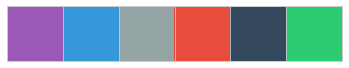

In [99]:
flatui = ["#9b59b6", "#3498db", "#95a5a6", "#e74c3c", "#34495e", "#2ecc71"]
sns.set_palette(flatui)
sns.palplot(sns.color_palette())

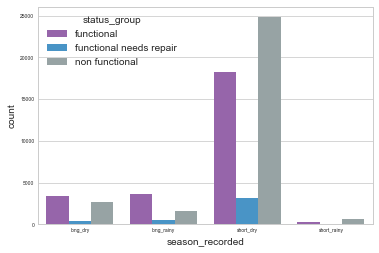

In [41]:
sns.set_style("whitegrid")

ax = sns.countplot(x='season_recorded', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('season_recorded',fontsize=10)
# ax.figure.savefig('ax_season_recorded.png', dpi = 1000)

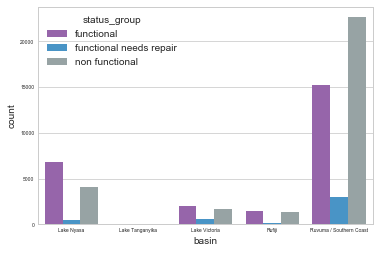

In [42]:
ax = sns.countplot(x='basin', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('basin',fontsize=10)
# ax.figure.savefig('ax_basin.png', dpi = 1000)

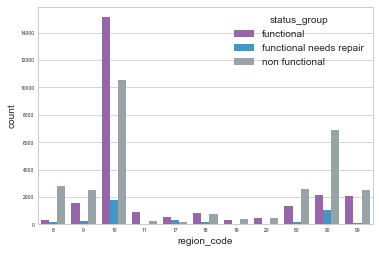

In [43]:
ax = sns.countplot(x='region_code', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('region_code',fontsize=10)
# ax.figure.savefig('ax_region_code.png', dpi = 1000)

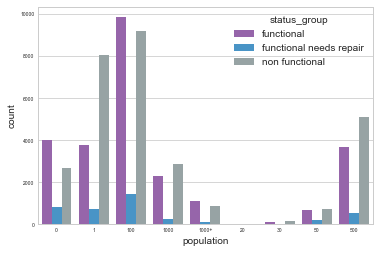

In [44]:
ax = sns.countplot(x='population', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('population',fontsize=10)
# ax.figure.savefig('ax_population.png', dpi = 1000)

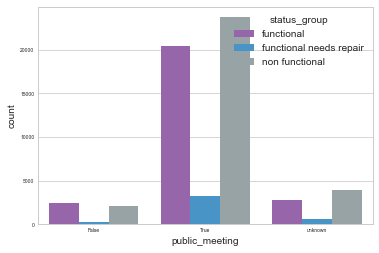

In [45]:
ax = sns.countplot(x='public_meeting', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('public_meeting',fontsize=10)
# ax.figure.savefig('ax_public_meeting.png', dpi = 1000)

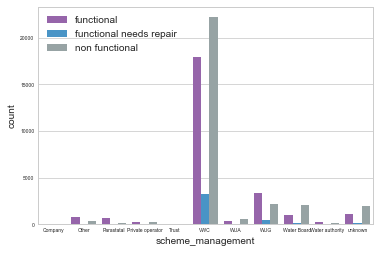

In [46]:
ax = sns.countplot(x='scheme_management', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('scheme_management',fontsize=10)
ax.legend(loc='upper left')
# ax.figure.savefig('ax_scheme_management.png', dpi = 1000)

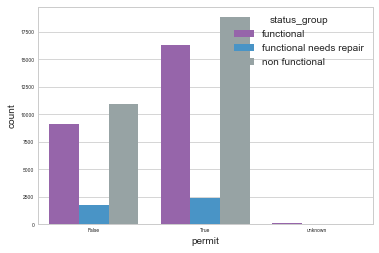

In [47]:
ax = sns.countplot(x='permit', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('permit',fontsize=10)
# ax.figure.savefig('ax_permit.png', dpi = 1000)

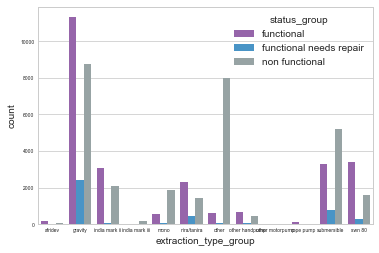

In [48]:
ax = sns.countplot(x='extraction_type_group', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('extraction_type_group',fontsize=10)
# ax.figure.savefig('ax_extraction_type_group.png', dpi = 1000)

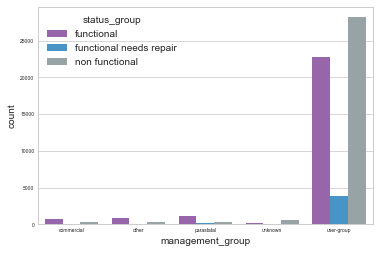

In [49]:
ax = sns.countplot(x='management_group', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('management_group',fontsize=10)
# ax.figure.savefig('ax_management_group.png', dpi = 1000)

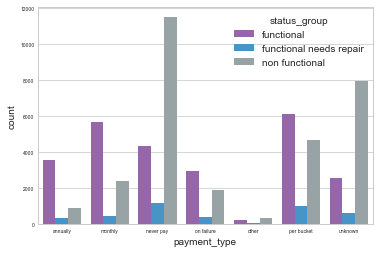

In [50]:
ax = sns.countplot(x='payment_type', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('payment_type',fontsize=10)
# ax.figure.savefig('ax_payment_type.png', dpi = 1000)

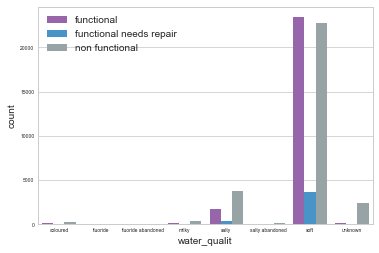

In [51]:
ax = sns.countplot(x='water_quality', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('water_qualit',fontsize=10)
ax.legend(loc='upper left')
# ax.figure.savefig('ax_water_quality.png', dpi = 1000)

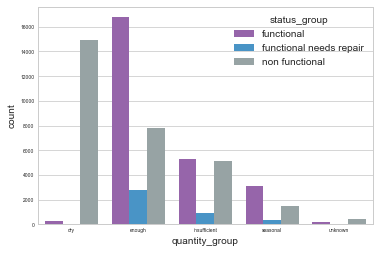

In [52]:
ax = sns.countplot(x='quantity_group', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('quantity_group',fontsize=10)
# ax.figure.savefig('ax_quantity_group.png', dpi = 1000)

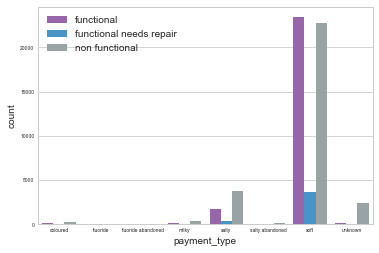

In [53]:
ax = sns.countplot(x='water_quality', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('payment_type',fontsize=10)
ax.legend(loc='upper left')
# ax.figure.savefig('ax_payment_type.png', dpi = 1000)

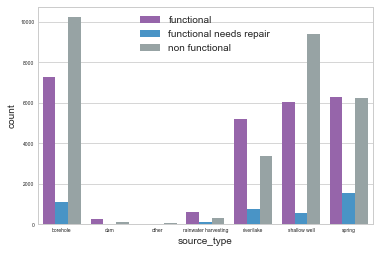

In [54]:
ax = sns.countplot(x='source_type', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('source_type',fontsize=10)
ax.legend(loc='upper center')
# ax.figure.savefig('ax_source_type.png', dpi = 1000)

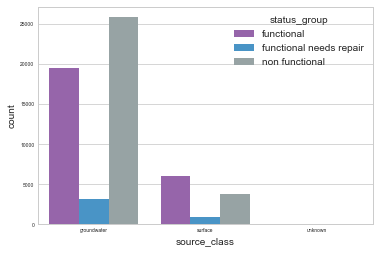

In [55]:
ax = sns.countplot(x='source_class', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('source_class',fontsize=10)
# ax.figure.savefig('ax_source_class.png', dpi = 1000)

Text(0.5,0,'waterpoint_type_group')

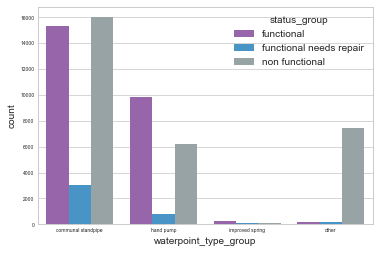

In [100]:
ax = sns.countplot(x='waterpoint_type_group', hue='status_group', data=df)
ax.tick_params(labelsize=5)
ax.set_xlabel('waterpoint_type_group',fontsize=10)
# ax.figure.savefig('ax_waterpoint_type_group', dpi = 1000)

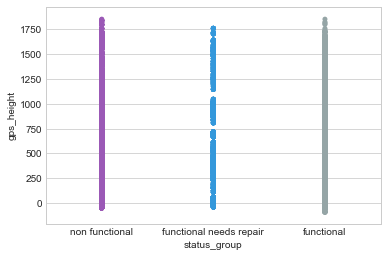

In [57]:
ax = sns.stripplot(x="status_group", y="gps_height", data=df, jitter=False, order=[ "non functional", "functional needs repair", "functional"])
# ax.figure.savefig('ax_gps_height', dpi = 1000)

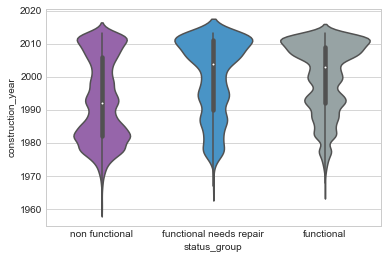

In [58]:
ax = sns.violinplot(x="status_group", y='construction_year', data=df, order=[ "non functional", "functional needs repair", "functional"])
# ax.figure.savefig('ax_construction_year', dpi = 1000)

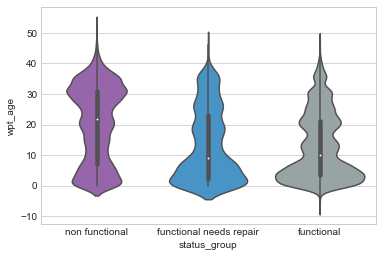

In [59]:
ax = sns.violinplot(x="status_group", y='wpt_age', data=df, order=[ "non functional", "functional needs repair", "functional"])
# ax.figure.savefig('ax_wpt_age', dpi = 1000)

# Tanzania - data analysis

In [17]:
import matplotlib.pylab as plt
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report
import sklearn.metrics

Sklearn decision trees and random forests need categorical data changed into integers.
See, e.g,: https://stackoverflow.com/questions/38108832/passing-categorical-data-to-sklearn-decision-tree

Booleans were already tackled in the Get rid of NaNs section with a home-made function.

Since the sklearn preprocessing using LabelEncoder doesn't seem t want to work, I'll convert the remaining (non-Boolean) variables 
, the sklearn own preprocessing does not work.


In [18]:
df.columns

Index(['id', 'date_recorded', 'season_recorded', 'gps_height', 'installer',
       'longitude', 'latitude', 'basin', 'region_code', 'population',
       'public_meeting', 'scheme_management', 'permit', 'wpt_age',
       'construction_year', 'extraction_type_group', 'management_group',
       'payment_type', 'water_quality', 'quantity_group', 'source_type',
       'source_class', 'waterpoint_type_group', 'status_group'],
      dtype='object')

In [19]:
# these will be encoded by sklearn LabelEncoder
nonbool_cat_vars = {'id', 'season_recorded', 'installer', 'basin', 'region_code', 
                    'population', 'scheme_management', 'extraction_type_group', 
                    'management_group','payment_type', 'water_quality', 'quantity_group', 
                    'source_type', 'source_class', 'waterpoint_type_group', 'status_group'
                   }

In [20]:
# create a mapping dict
# to convert class labels from strings to integers
class_mapping = {label: idx for idx, label in enumerate(np.unique(df['extraction_type_group']))}
class_mapping

{'afridev': 0,
 'gravity': 1,
 'india mark ii': 2,
 'india mark iii': 3,
 'mono': 4,
 'nira/tanira': 5,
 'other': 6,
 'other handpump': 7,
 'other motorpump': 8,
 'rope pump': 9,
 'submersible': 10,
 'swn 80': 11}

In [21]:
from sklearn.preprocessing import LabelEncoder
class_le = LabelEncoder()
y = class_le.fit_transform(df['season_recorded'].values)
print(y)

[2 2 2 ... 2 2 0]


In [22]:
non_bool_categoric = ['season_recorded', 'installer', 'basin', 'region_code', 'population',
                       'scheme_management', 'extraction_type_group', 'management_group', 
                      'payment_type', 'water_quality', 'quantity_group', 'source_type', 
                      'waterpoint_type_group'
                     ]

for nbc in nonbool_cat_vars:
    class_le = LabelEncoder()
    df[nbc] = class_le.fit_transform(df[nbc].values)
    print(df[nbc][:5])

0    1
1    1
2    1
3    3
4    1
Name: waterpoint_type_group, dtype: int64
0     35
1     35
2    187
3    112
4     44
Name: installer, dtype: int64
0    1
1    1
2    1
3    8
4    2
Name: population, dtype: int64
0    4
1    4
2    4
3    3
4    4
Name: management_group, dtype: int64
0    0
1    0
2    0
3    0
4    0
Name: source_class, dtype: int64
0    11
1    11
2    11
3     6
4    11
Name: extraction_type_group, dtype: int64
0    0
1    0
2    0
3    0
4    5
Name: source_type, dtype: int64
0    2
1    2
2    2
3    2
4    2
Name: region_code, dtype: int64
0    2
1    2
2    2
3    2
4    2
Name: season_recorded, dtype: int64
0    2505
1    5369
2    7163
3      47
4    6423
Name: id, dtype: int64
0    1
1    1
2    2
3    2
4    2
Name: status_group, dtype: int64
0    4
1    4
2    4
3    4
4    4
Name: basin, dtype: int64
0     5
1     5
2     5
3    10
4     7
Name: scheme_management, dtype: int64
0    0
1    0
2    2
3    6
4    1
Name: payment_type, dtype: int64
0    6


N.B. that source_class has been removed. (Had little info in it.)

In [23]:
df.to_csv('/Users/RAhmed/data store/Wesleyan_Capstone/corrected_data05.csv', index=False)

In [24]:
df.columns

Index(['id', 'date_recorded', 'season_recorded', 'gps_height', 'installer',
       'longitude', 'latitude', 'basin', 'region_code', 'population',
       'public_meeting', 'scheme_management', 'permit', 'wpt_age',
       'construction_year', 'extraction_type_group', 'management_group',
       'payment_type', 'water_quality', 'quantity_group', 'source_type',
       'source_class', 'waterpoint_type_group', 'status_group'],
      dtype='object')

In [25]:
chosen_predictors = ['season_recorded', 'gps_height', 'installer', 'basin', 'region_code', 'population',
                     'public_meeting', 'scheme_management', 'permit', 'wpt_age','construction_year', 
                     'extraction_type_group', 'management_group', 'payment_type', 'water_quality', 
                     'quantity_group', 'source_type', 'waterpoint_type_group'
                    ]

predictors = df[chosen_predictors]
targets = df['status_group']

# train/test split
pred_train, pred_test, tar_train, tar_test = train_test_split(predictors, targets, test_size=.2)

print("pred_train.shape:", pred_train.shape)
print("pred_test.shape:", pred_test.shape)
print("tar_train.shape:", tar_train.shape)
print("tar_test.shape:", tar_test.shape)

pred_train.shape: (47520, 18)
pred_test.shape: (11880, 18)
tar_train.shape: (47520,)
tar_test.shape: (11880,)


Build a classifier model with a decision tree, on train set

In [26]:
# Build model on training data; initiate classifier from sklearn, then fit it with the training data
classifier=DecisionTreeClassifier()
classifier=classifier.fit(pred_train,tar_train)

# predict for the test values and create confusion matrix
predictions=classifier.predict(pred_test)
print("Confusion matrix:")
print(sklearn.metrics.confusion_matrix(tar_test,predictions))
print("Accuracy score:")
print(sklearn.metrics.accuracy_score(tar_test, predictions))


Confusion matrix:
[[4962   40   61]
 [  54  783   13]
 [  63   15 5889]]
Accuracy score:
0.9792929292929293


Trying again, to play with parameters, experiment, etc.

In [42]:
# Playing with hyper-parameters. Also have varied the wording of the code from that in the MOOC. 
# (Just to check all in order with exceptionally high result.)
# train/test split
from sklearn.utils import shuffle
df = shuffle(df)
X_train, X_test, y_train, y_test = train_test_split(predictors[:], targets[:], test_size=.2)

# Build model on training data; initiate classifier from sklearn, then fit it with the training data
model = DecisionTreeClassifier()
model.fit(X_train, y_train)

y_predict = model.predict(X_test)

from sklearn.metrics import accuracy_score

accuracy_score(y_test, y_predict)

0.9771885521885522

For confusion matrix, N.B. that:
> functional = 0

> functional_needs_repair = 1

> non-functional = 2

In [43]:
from sklearn.metrics import confusion_matrix

pd.DataFrame(
    confusion_matrix(y_test, y_predict),
    columns=['Pred functional', 'Predicted func_need_repair', 'Predicted non_func'],
    index=['True functional', 'True func_need_repair', 'True non_func']
)

,Pred functional,Predicted func_need_repair,Predicted non_func
True functional,4999,45,45
True func_need_repair,70,698,12
True non_func,84,15,5912


In [44]:
# reprint for convenience
accuracy_score(y_test, y_predict)

0.9771885521885522

Got this from: https://gist.github.com/shaypal5/94c53d765083101efc0240d776a23823

In [45]:
def print_confusion_matrix(confusion_matrix, class_names, figsize = (10,7), fontsize=14):
    """Prints a confusion matrix, as returned by sklearn.metrics.confusion_matrix, as a heatmap.
    
    Arguments
    ---------
    confusion_matrix: numpy.ndarray
        The numpy.ndarray object returned from a call to sklearn.metrics.confusion_matrix. 
        Similarly constructed ndarrays can also be used.
    class_names: list
        An ordered list of class names, in the order they index the given confusion matrix.
    figsize: tuple
        A 2-long tuple, the first value determining the horizontal size of the ouputted figure,
        the second determining the vertical size. Defaults to (10,7).
    fontsize: int
        Font size for axes labels. Defaults to 14.
        
    Returns
    -------
    matplotlib.figure.Figure
        The resulting confusion matrix figure
    """
    df_cm = pd.DataFrame(
        confusion_matrix, index=class_names, columns=class_names, 
    )
    fig = plt.figure(figsize=figsize)
    try:
        heatmap = sns.heatmap(df_cm, annot=True, fmt="d")
    except ValueError:
        raise ValueError("Confusion matrix values must be integers.")
    heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=fontsize)
    heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=45, ha='right', fontsize=fontsize)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    return fig

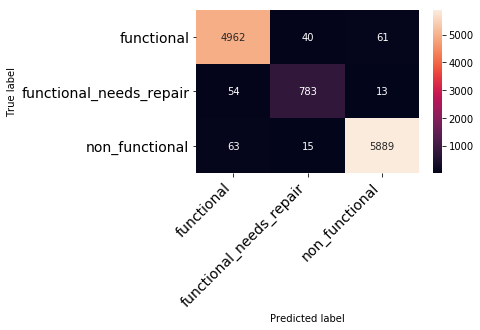

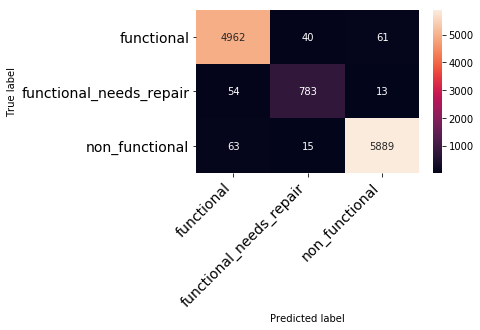

In [46]:
confusion_matrix = sklearn.metrics.confusion_matrix(tar_test,predictions)
print_confusion_matrix(confusion_matrix, ['functional', 'functional_needs_repair', 'non_functional'], figsize = (5,3), fontsize=14)

In [47]:
# to check the first 50 predictions - what they are
y_predict[:50]

array([2, 2, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 0,
       0, 0, 2, 0, 1, 2, 2, 0, 0, 2, 0, 0, 2, 0, 1, 2, 2, 2, 2, 0, 0, 0,
       2, 0, 2, 2, 0, 2])

In [48]:
# find importance of variables
model.feature_importances_

array([0.00640325, 0.20924236, 0.04005624, 0.04455583, 0.01826248,
       0.03945031, 0.00883434, 0.00547754, 0.00574168, 0.09484086,
       0.04274042, 0.03126107, 0.01279957, 0.0537345 , 0.00671046,
       0.28047822, 0.01221229, 0.08719857])

Key ingredient: see which features are most important

In [49]:
importance = (dict(zip(X_train, model.feature_importances_)))
importance

{'season_recorded': 0.0064032479669352575,
 'gps_height': 0.2092423594251501,
 'installer': 0.040056237522998146,
 'basin': 0.04455582878100932,
 'region_code': 0.018262477457917908,
 'population': 0.03945031334114885,
 'public_meeting': 0.00883433774891647,
 'scheme_management': 0.005477542092812738,
 'permit': 0.005741683535756479,
 'wpt_age': 0.09484086121556344,
 'construction_year': 0.042740424679401104,
 'extraction_type_group': 0.031261073576510444,
 'management_group': 0.012799567300097266,
 'payment_type': 0.0537344998778335,
 'water_quality': 0.0067104615963383,
 'quantity_group': 0.2804782197522102,
 'source_type': 0.012212293771450061,
 'waterpoint_type_group': 0.08719857035795034}

In [50]:
sorted_items = sorted(importance.items(), key = lambda x: x[1], reverse=True)
sorted_items

[('quantity_group', 0.2804782197522102),
 ('gps_height', 0.2092423594251501),
 ('wpt_age', 0.09484086121556344),
 ('waterpoint_type_group', 0.08719857035795034),
 ('payment_type', 0.0537344998778335),
 ('basin', 0.04455582878100932),
 ('construction_year', 0.042740424679401104),
 ('installer', 0.040056237522998146),
 ('population', 0.03945031334114885),
 ('extraction_type_group', 0.031261073576510444),
 ('region_code', 0.018262477457917908),
 ('management_group', 0.012799567300097266),
 ('source_type', 0.012212293771450061),
 ('public_meeting', 0.00883433774891647),
 ('water_quality', 0.0067104615963383),
 ('season_recorded', 0.0064032479669352575),
 ('permit', 0.005741683535756479),
 ('scheme_management', 0.005477542092812738)]

In [51]:
# visualise
tree.export_graphviz(model, out_file='tree.dot') 
# cut and paste the tree.dot file info into webgraphviz.com in a browser. 
# (You can paste as many layers of the tree as you want.)

In [57]:
from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())